## 0. Goal
Use the same VAE inputs, but vary parameters for UMAP to find the best option. Use V4 and V5 as the example. <br> 
Parameters to vary:
1. n_neighbors [25 50 100]
2. min_dist [0 0.15 0.3]
3. metrics ['Euclidean', 'Cosine']
4. standardize VAE latents [yes, no]
5. use exact KNN method [yes, no]

In [1]:
import os, sys, importlib, librosa, glob, h5py, tqdm, pickle
from scipy.io import wavfile
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from joblib import Parallel, delayed
import random
import umap, hdbscan
from collections import Counter, OrderedDict
import seaborn as sns
from torch.utils.data import Dataset, DataLoader, TensorDataset
import torch
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch
from skimage import transform
import gc
import colorsys
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

plt.rcParams['pdf.fonttype'] = 42 

In [2]:
# import my utility script
cluster_script_path = '/home/zz367/ProjectsU/EphysMONAO/Jupyter/MatlabCodes/ZZ_callClustering/'
sys.path.insert(1, cluster_script_path)
import vae_goffinet, hopkins
importlib.reload(vae_goffinet)

<module 'vae_goffinet' from '/home/zz367/ProjectsU/EphysMONAO/Jupyter/MatlabCodes/ZZ_callClustering/vae_goffinet.py'>

In [3]:
# create a custom colormap for spectrogram
jet = plt.get_cmap('jet', 255)
# Extract jet colors and prepend black at the beginning
jet_colors = jet(np.linspace(0, 1, 255))
custom_colors = np.vstack([[0, 0, 0, 1], jet_colors])  # Black for 0, then jet
custom_cmap = ListedColormap(custom_colors)

## 1. Inputs

In [4]:
fd_z4 = '/mnt/z4'
fd_data = os.path.join(fd_z4, 'zz367', 'EphysMONAO', 'Analyzed', 'vaeWav')
birdID = 'pair5RigCCU29'
# color limits when calculating spectrograms, depending on the audio amplitude, may differ between birds
clims = [1.5,7]
# what syllable pairs to analyze
v_all = ['v4', 'v5']
# what spectogram datasets to use
spec_suffix = 'Spectrogram1'
spec_run = 'spec_goffinet_traj_256_236'
# what VAE run to use
vae_suffix = 'VAE1'
vae_run = 'traj_chop_32_2_32'
fd_vae = os.path.join(fd_data, birdID, 'Traj', vae_suffix, vae_run)
# where the VAE latents results are saved
apply_suffix = 'applySyl1'
apply_run = f'latent.{vae_run}'
fd_latent = os.path.join(fd_data, birdID, 'Traj', apply_suffix, apply_run)
print(fd_latent)

/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/latent.traj_chop_32_2_32


In [5]:
# where to save results
fd_save = os.path.join(fd_data, birdID, 'Traj', apply_suffix, 'paramSearch1')
if not os.path.exists(fd_save):
    os.makedirs(fd_save)
print(fd_save)

/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1


In [6]:
# grab the info on syllales
fn_merged = os.path.join(fd_latent, f'{birdID}.info_merged.csv')
info_syl = pd.read_csv(fn_merged, index_col=0)
# construct a unique syllable id
info_syl['syl_id'] = [f'{info_syl["fn_wav"][ii]}_{info_syl["s_idx"][ii]}' for ii in info_syl.index]
info_syl = info_syl.reset_index()  # reset index for easy merging later

In [7]:
# how many syllables to include for each type
num_syl = 300
# set a threshold to get confident cluster only 
hdbscan_thre = 0.9

In [8]:
# grab the latent data and info for each call subytpe
fns_latent = sorted(glob.glob(os.path.join(fd_latent, 'latentM.v*.csv')))
# read in all data
latent_comb = np.empty((0, 32))
info_comb = pd.DataFrame()
for v in v_all:
    fn = sorted(glob.glob(os.path.join(fd_latent, f'latentM.{v}.csv')))[0]
    latent = np.loadtxt(fn, delimiter=',')
    fn_info = os.path.join(os.path.dirname(fn), f'info.{v}.csv')
    info = pd.read_csv(fn_info, index_col=0)
    
    # merge the syllable info to sliding window info
    merged_info = info.merge(info_syl, left_on='ri', right_on='index', how='left')
    
    #### sample data as UMAP inputs
    info_pass = merged_info[merged_info['hdbscan_prob']>=hdbscan_thre]
    if info_pass.empty:
        continue
    # get unique syllable id
    syl_uniq = sorted(list(set(info_pass['syl_id'])))
    # same syllables
    num_sample = min([num_syl, len(syl_uniq)])
    print(f'Total syllable {len(set(merged_info["syl_id"]))}. Pass threshold {len(syl_uniq)}. Sampled {num_sample}')
    random.seed(1118)
    syl_rd = random.sample(syl_uniq, num_sample)

    # get the latent data
    iwin = merged_info[merged_info['syl_id'].isin(syl_rd)].index
    info_rd = merged_info.iloc[iwin, :]
    latent_rd = latent[iwin, :]
    print(latent_rd.shape, info_rd.shape)
    
    latent_comb = np.vstack([latent_comb, latent_rd])
    info_comb = pd.concat([info_comb, info_rd], ignore_index=True)

Total syllable 2421. Pass threshold 1228. Sampled 300
(30780, 32) (30780, 21)
Total syllable 1519. Pass threshold 1359. Sampled 300
(30372, 32) (30372, 21)


In [10]:
print(latent_comb.shape, info_comb.shape)
# save it to disk 
syl_str = ''.join(v_all)
fn_latent = os.path.join(fd_save, f'{syl_str}_latent_comb.csv')
np.savetxt(fn_latent, latent_comb)
fn_info = os.path.join(fd_save, f'{syl_str}_info_comb.csv')
info_comb.to_csv(fn_info)

(61152, 32) (61152, 21)


## 2. Do the parameter search on UMAP

In [30]:
n_neighbors = [25, 50, 100, 300]
min_dist = [0, 0.15, 0.3]
metrics = ['euclidean', 'cosine']
vae_standard = [0, 1]
knn_exact = [0, 1]

In [28]:
# nn = 1000
# md = 0
# mt = 'euclidean'
# vs = 0
# ke = 0

/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_euclidean_vs0_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:12:02 2025 Construct fuzzy simplicial set
Wed Jul 23 17:12:02 2025 Finding Nearest Neighbors
Wed Jul 23 17:12:02 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:12:02 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:12:05 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:12:05 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:12:39 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 2737, 26952, 28525],
       [    1, 56622, 52986, ..., 56718, 16383, 58301],
       [    2, 3, 1, ..., 20801, 37288, 44357],
       ...,
       [61149, 55594, 57624, ..., 51951, 45862, 54904],
       [61150, 57625, 54904, ..., 18798, 55793, 18800],
       [61151, 46357, 40705, ..., 17272, 39164, 17170]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 8.1069994e-01,
        8.1746972e-01, 8.3091956e-01],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 9.9644053e-01,
        1.0054610e+00, 1.0070863e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.0712208e+00,
        1.0838194e+00, 1.0858886e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 6.9713891e-01,
        6.9987994e-01, 7.0205230e-01],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 6.4365488e-01,
        6.4775169e-01, 6.4810491e-01],
       [0

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:13:20 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_euclidean_vs1_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:13:31 2025 Construct fuzzy simplicial set
Wed Jul 23 17:13:31 2025 Finding Nearest Neighbors
Wed Jul 23 17:13:31 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:13:32 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:13:34 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:13:34 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:14:00 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 12579, 5594, 7205],
       [    1, 56622, 2, ..., 6875, 58883, 16383],
       [    2, 3, 1, ..., 16383, 7313, 44358],
       ...,
       [61149, 55594, 57624, ..., 45863, 57625, 57279],
       [61150, 57625, 6427, ..., 55793, 46356, 55594],
       [61151, 46556, 28706, ..., 91, 44967, 29267]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 1.7187626 , 1.719836  ,
        1.7239258 ],
       [0.        , 0.81940883, 1.265001  , ..., 1.9065647 , 1.9203895 ,
        1.9452224 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.0262797 , 2.0295866 ,
        2.03328   ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 1.4027784 , 1.4164706 ,
        1.4731635 ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.4403143 , 1.4498464 ,
        1.4517901 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.250787  , 1.2600913 ,
        1.2608447 ]], dtype=float32))

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:14:41 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:14:52 2025 Construct fuzzy simplicial set
Wed Jul 23 17:14:52 2025 Finding Nearest Neighbors
Wed Jul 23 17:14:52 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:14:53 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:14:55 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:14:56 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:15:25 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 35449, 55994, ..., 57459, 7644, 46148],
       [    1, 56622, 52986, ..., 54046, 51392, 21007],
       [    2, 1, 3, ..., 4106, 56900, 26041],
       ...,
       [61149, 55594, 57624, ..., 42469, 59660, 57625],
       [61150, 57625, 54904, ..., 51119, 40703, 60321],
       [61151, 55794, 42472, ..., 59662, 39164, 48200]]), array([[1.1102230e-16, 1.5836706e-02, 1.8996913e-02, ..., 3.2322574e-02,
        3.2470141e-02, 3.2606982e-02],
       [2.2204460e-16, 1.7178539e-02, 1.9883528e-02, ..., 6.7806639e-02,
        6.8538658e-02, 6.9541045e-02],
       [2.2204460e-16, 3.3203319e-02, 3.7032846e-02, ..., 9.2835397e-02,
        9.8047331e-02, 9.8105356e-02],
       ...,
       [0.0000000e+00, 6.7821578e-03, 1.6349655e-02, ..., 3.1803135e-02,
        3.2396637e-02, 3.3100303e-02],
       [0.0000000e+00, 4.9243048e-03, 7.9164328e-03, ..., 2.7148200e-02,
        

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:16:48 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:17:00 2025 Construct fuzzy simplicial set
Wed Jul 23 17:17:00 2025 Finding Nearest Neighbors
Wed Jul 23 17:17:00 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:17:00 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:17:03 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:17:04 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:17:28 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 7312, 2737, 54046],
       [    1, 56622, 2, ..., 51771, 44358, 40362],
       [    2, 3, 1, ..., 52987, 42596, 56901],
       ...,
       [61149, 55594, 57624, ..., 56614, 58088, 57279],
       [61150, 57625, 6427, ..., 42471, 55793, 56616],
       [61151, 46556, 42472, ..., 17170, 53642, 9014]]), array([[0.0000000e+00, 2.4112212e-02, 3.0417792e-02, ..., 4.8905771e-02,
        4.9268585e-02, 5.0113004e-02],
       [0.0000000e+00, 1.2931155e-02, 2.7091267e-02, ..., 6.7573920e-02,
        6.8143077e-02, 7.1821705e-02],
       [0.0000000e+00, 2.5641430e-02, 2.7091267e-02, ..., 6.7308985e-02,
        6.8013877e-02, 6.8253309e-02],
       ...,
       [0.0000000e+00, 9.9245301e-03, 1.4124042e-02, ..., 3.4837563e-02,
        3.5360489e-02, 3.5466101e-02],
       [0.0000000e+00, 5.5933502e-03, 1.2811135e-02, ..., 3.8410321e-02,
        3.9392

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:18:51 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_euclidean_vs0_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:19:02 2025 Construct fuzzy simplicial set
Wed Jul 23 17:19:02 2025 Finding Nearest Neighbors
Wed Jul 23 17:19:02 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:19:03 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:19:05 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:19:05 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:19:31 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 2737, 26952, 28525],
       [    1, 56622, 52986, ..., 56718, 16383, 58301],
       [    2, 3, 1, ..., 20801, 37288, 44357],
       ...,
       [61149, 55594, 57624, ..., 51951, 45862, 54904],
       [61150, 57625, 54904, ..., 18798, 55793, 18800],
       [61151, 46357, 40705, ..., 17272, 39164, 17170]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 8.1069994e-01,
        8.1746972e-01, 8.3091956e-01],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 9.9644053e-01,
        1.0054610e+00, 1.0070863e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.0712208e+00,
        1.0838194e+00, 1.0858886e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 6.9713891e-01,
        6.9987994e-01, 7.0205230e-01],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 6.4365488e-01,
        6.4775169e-01, 6.4810491e-01],
      

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:20:10 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_euclidean_vs1_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:20:22 2025 Construct fuzzy simplicial set
Wed Jul 23 17:20:22 2025 Finding Nearest Neighbors
Wed Jul 23 17:20:22 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:20:22 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:20:25 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:20:25 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:20:50 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 12579, 5594, 7205],
       [    1, 56622, 2, ..., 6875, 58883, 16383],
       [    2, 3, 1, ..., 16383, 7313, 44358],
       ...,
       [61149, 55594, 57624, ..., 45863, 57625, 57279],
       [61150, 57625, 6427, ..., 55793, 46356, 55594],
       [61151, 46556, 28706, ..., 91, 44967, 29267]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 1.7187626 , 1.719836  ,
        1.7239258 ],
       [0.        , 0.81940883, 1.265001  , ..., 1.9065647 , 1.9203895 ,
        1.9452224 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.0262797 , 2.0295866 ,
        2.03328   ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 1.4027784 , 1.4164706 ,
        1.4731635 ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.4403143 , 1.4498464 ,
        1.4517901 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.250787  , 1.2600913 ,
        1.2608447 ]], dtype=float3

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:21:38 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:21:50 2025 Construct fuzzy simplicial set
Wed Jul 23 17:21:50 2025 Finding Nearest Neighbors
Wed Jul 23 17:21:50 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:21:50 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:21:53 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:21:53 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:22:36 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 35449, 55994, ..., 57459, 7644, 46148],
       [    1, 56622, 52986, ..., 54046, 51392, 21007],
       [    2, 1, 3, ..., 4106, 56900, 26041],
       ...,
       [61149, 55594, 57624, ..., 42469, 59660, 57625],
       [61150, 57625, 54904, ..., 51119, 40703, 60321],
       [61151, 55794, 42472, ..., 59662, 39164, 48200]]), array([[1.1102230e-16, 1.5836706e-02, 1.8996913e-02, ..., 3.2322574e-02,
        3.2470141e-02, 3.2606982e-02],
       [2.2204460e-16, 1.7178539e-02, 1.9883528e-02, ..., 6.7806639e-02,
        6.8538658e-02, 6.9541045e-02],
       [2.2204460e-16, 3.3203319e-02, 3.7032846e-02, ..., 9.2835397e-02,
        9.8047331e-02, 9.8105356e-02],
       ...,
       [0.0000000e+00, 6.7821578e-03, 1.6349655e-02, ..., 3.1803135e-02,
        3.2396637e-02, 3.3100303e-02],
       [0.0000000e+00, 4.9243048e-03, 7.9164328e-03, ..., 2.7148200e-02,
     

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:24:09 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:24:21 2025 Construct fuzzy simplicial set
Wed Jul 23 17:24:21 2025 Finding Nearest Neighbors
Wed Jul 23 17:24:21 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:24:21 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:24:24 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:24:24 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:24:58 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.15_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 7312, 2737, 54046],
       [    1, 56622, 2, ..., 51771, 44358, 40362],
       [    2, 3, 1, ..., 52987, 42596, 56901],
       ...,
       [61149, 55594, 57624, ..., 56614, 58088, 57279],
       [61150, 57625, 6427, ..., 42471, 55793, 56616],
       [61151, 46556, 42472, ..., 17170, 53642, 9014]]), array([[0.0000000e+00, 2.4112212e-02, 3.0417792e-02, ..., 4.8905771e-02,
        4.9268585e-02, 5.0113004e-02],
       [0.0000000e+00, 1.2931155e-02, 2.7091267e-02, ..., 6.7573920e-02,
        6.8143077e-02, 7.1821705e-02],
       [0.0000000e+00, 2.5641430e-02, 2.7091267e-02, ..., 6.7308985e-02,
        6.8013877e-02, 6.8253309e-02],
       ...,
       [0.0000000e+00, 9.9245301e-03, 1.4124042e-02, ..., 3.4837563e-02,
        3.5360489e-02, 3.5466101e-02],
       [0.0000000e+00, 5.5933502e-03, 1.2811135e-02, ..., 3.8410321e-02,
        3.9

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:26:30 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_euclidean_vs0_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:26:42 2025 Construct fuzzy simplicial set
Wed Jul 23 17:26:42 2025 Finding Nearest Neighbors
Wed Jul 23 17:26:42 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:26:42 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:26:45 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:26:45 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:27:19 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 2737, 26952, 28525],
       [    1, 56622, 52986, ..., 56718, 16383, 58301],
       [    2, 3, 1, ..., 20801, 37288, 44357],
       ...,
       [61149, 55594, 57624, ..., 51951, 45862, 54904],
       [61150, 57625, 54904, ..., 18798, 55793, 18800],
       [61151, 46357, 40705, ..., 17272, 39164, 17170]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 8.1069994e-01,
        8.1746972e-01, 8.3091956e-01],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 9.9644053e-01,
        1.0054610e+00, 1.0070863e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.0712208e+00,
        1.0838194e+00, 1.0858886e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 6.9713891e-01,
        6.9987994e-01, 7.0205230e-01],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 6.4365488e-01,
        6.4775169e-01, 6.4810491e-01],
       

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:28:06 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_euclidean_vs1_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:28:18 2025 Construct fuzzy simplicial set
Wed Jul 23 17:28:18 2025 Finding Nearest Neighbors
Wed Jul 23 17:28:18 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:28:18 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:28:21 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:28:21 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:28:56 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 12579, 5594, 7205],
       [    1, 56622, 2, ..., 6875, 58883, 16383],
       [    2, 3, 1, ..., 16383, 7313, 44358],
       ...,
       [61149, 55594, 57624, ..., 45863, 57625, 57279],
       [61150, 57625, 6427, ..., 55793, 46356, 55594],
       [61151, 46556, 28706, ..., 91, 44967, 29267]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 1.7187626 , 1.719836  ,
        1.7239258 ],
       [0.        , 0.81940883, 1.265001  , ..., 1.9065647 , 1.9203895 ,
        1.9452224 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.0262797 , 2.0295866 ,
        2.03328   ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 1.4027784 , 1.4164706 ,
        1.4731635 ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.4403143 , 1.4498464 ,
        1.4517901 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.250787  , 1.2600913 ,
        1.2608447 ]], dtype=float32

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:29:44 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:29:56 2025 Construct fuzzy simplicial set
Wed Jul 23 17:29:56 2025 Finding Nearest Neighbors
Wed Jul 23 17:29:56 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:29:56 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:29:59 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:30:00 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:30:43 2025 Finished embedding


/tmp/ipykernel_4022550/228825273.py:49: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1, ncols=1, figsize=[5, 5])


/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 35449, 55994, ..., 57459, 7644, 46148],
       [    1, 56622, 52986, ..., 54046, 51392, 21007],
       [    2, 1, 3, ..., 4106, 56900, 26041],
       ...,
       [61149, 55594, 57624, ..., 42469, 59660, 57625],
       [61150, 57625, 54904, ..., 51119, 40703, 60321],
       [61151, 55794, 42472, ..., 59662, 39164, 48200]]), array([[1.1102230e-16, 1.5836706e-02, 1.8996913e-02, ..., 3.2322574e-02,
        3.2470141e-02, 3.2606982e-02],
       [2.2204460e-16, 1.7178539e-02, 1.9883528e-02, ..., 6.7806639e-02,
        6.8538658e-02, 6.9541045e-02],
       [2.2204460e-16, 3.3203319e-02, 3.7032846e-02, ..., 9.2835397e-02,
        9.8047331e-02, 9.8105356e-02],
       ...,
       [0.0000000e+00, 6.7821578e-03, 1.6349655e-02, ..., 3.1803135e-02,
        3.2396637e-02, 3.3100303e-02],
       [0.0000000e+00, 4.9243048e-03, 7.9164328e-03, ..., 2.7148200e-02,
      

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:32:13 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=25, random_state=1118, verbose=True)
Wed Jul 23 17:32:25 2025 Construct fuzzy simplicial set
Wed Jul 23 17:32:25 2025 Finding Nearest Neighbors
Wed Jul 23 17:32:25 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:32:25 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:32:28 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:32:28 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:33:02 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn25_md0.3_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=25, precomputed_knn=(array([[    0, 22836, 40362, ..., 7312, 2737, 54046],
       [    1, 56622, 2, ..., 51771, 44358, 40362],
       [    2, 3, 1, ..., 52987, 42596, 56901],
       ...,
       [61149, 55594, 57624, ..., 56614, 58088, 57279],
       [61150, 57625, 6427, ..., 42471, 55793, 56616],
       [61151, 46556, 42472, ..., 17170, 53642, 9014]]), array([[0.0000000e+00, 2.4112212e-02, 3.0417792e-02, ..., 4.8905771e-02,
        4.9268585e-02, 5.0113004e-02],
       [0.0000000e+00, 1.2931155e-02, 2.7091267e-02, ..., 6.7573920e-02,
        6.8143077e-02, 7.1821705e-02],
       [0.0000000e+00, 2.5641430e-02, 2.7091267e-02, ..., 6.7308985e-02,
        6.8013877e-02, 6.8253309e-02],
       ...,
       [0.0000000e+00, 9.9245301e-03, 1.4124042e-02, ..., 3.4837563e-02,
        3.5360489e-02, 3.5466101e-02],
       [0.0000000e+00, 5.5933502e-03, 1.2811135e-02, ..., 3.8410321e-02,
        3.93

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:34:27 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_euclidean_vs0_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:34:40 2025 Construct fuzzy simplicial set
Wed Jul 23 17:34:40 2025 Finding Nearest Neighbors
Wed Jul 23 17:34:40 2025 Building RP forest with 17 trees
Wed Jul 23 17:34:40 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:34:47 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:34:48 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:35:21 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 40816, 38603, 11512],
       [    1, 56622, 52986, ..., 40363, 3785, 40362],
       [    2, 3, 1, ..., 16382, 6878, 5486],
       ...,
       [61149, 55594, 57624, ..., 55793, 60321, 59264],
       [61150, 57625, 54904, ..., 28706, 53640, 44967],
       [61151, 46357, 40705, ..., 92, 41911, 29267]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 9.0899009e-01,
        9.0993249e-01, 9.1028249e-01],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.0999140e+00,
        1.1025028e+00, 1.1072494e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.1674638e+00,
        1.1826681e+00, 1.1877874e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 8.2600135e-01,
        8.3420944e-01, 8.4365511e-01],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 8.1772268e-01,
        8.1822020e-01, 8.3033395e-01],
       [0.0000

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:36:08 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_euclidean_vs1_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:36:19 2025 Construct fuzzy simplicial set
Wed Jul 23 17:36:19 2025 Finding Nearest Neighbors
Wed Jul 23 17:36:19 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:36:19 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:36:26 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:36:27 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:36:59 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 58883, 40816, 7415],
       [    1, 56622, 2, ..., 42259, 35013, 32532],
       [    2, 3, 1, ..., 19403, 54819, 3572],
       ...,
       [61149, 55594, 57624, ..., 33594, 28705, 18800],
       [61150, 57625, 6427, ..., 44865, 53641, 6425],
       [61151, 46556, 28706, ..., 56616, 57454, 57282]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 1.8451816 , 1.845721  ,
        1.8609153 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.1142697 , 2.1144497 ,
        2.1170392 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.3533614 , 2.3553524 ,
        2.3666534 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 1.7189131 , 1.7304218 ,
        1.7561152 ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.721304  , 1.7314698 ,
        1.7400032 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.4522179 , 1.45223   ,
        1.4560691 ]], dtype=float

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:37:47 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:37:58 2025 Construct fuzzy simplicial set
Wed Jul 23 17:37:58 2025 Finding Nearest Neighbors
Wed Jul 23 17:37:58 2025 Building RP forest with 17 trees
Wed Jul 23 17:37:58 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:38:07 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:38:08 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:38:43 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 35449, 55994, ..., 32749, 42930, 53841],
       [    1, 56622, 52986, ..., 17886, 19105, 26853],
       [    2, 1, 3, ..., 48008, 58092, 7313],
       ...,
       [61149, 55594, 57624, ..., 42468, 55595, 60321],
       [61150, 57625, 54904, ..., 21830, 6425, 53640],
       [61151, 55794, 42472, ..., 21630, 56616, 91]]), array([[1.11022302e-16, 1.58367064e-02, 1.89969130e-02, ...,
        4.03383449e-02, 4.10123989e-02, 4.12091017e-02],
       [2.22044605e-16, 1.71785392e-02, 1.98835284e-02, ...,
        7.98833147e-02, 8.02835673e-02, 8.03686976e-02],
       [2.22044605e-16, 3.32033187e-02, 3.70328464e-02, ...,
        1.15502045e-01, 1.16366595e-01, 1.16840519e-01],
       ...,
       [0.00000000e+00, 6.78215781e-03, 1.63496546e-02, ...,
        4.56397161e-02, 4.58033718e-02, 4.58994880e-02],
       [0.00000000e+00, 4.92430478e-03, 7.91643281e-03, ...,

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:40:14 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:40:26 2025 Construct fuzzy simplicial set
Wed Jul 23 17:40:26 2025 Finding Nearest Neighbors
Wed Jul 23 17:40:26 2025 Building RP forest with 17 trees
Wed Jul 23 17:40:26 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:40:35 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:40:36 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:41:08 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 58883, 28049, 29639],
       [    1, 56622, 2, ..., 35013, 26952, 42595],
       [    2, 3, 1, ..., 47697, 15977, 6878],
       ...,
       [61149, 55594, 57624, ..., 26239, 55793, 53278],
       [61150, 57625, 6427, ..., 56614, 29266, 53640],
       [61151, 46556, 42472, ..., 46046, 25152, 7862]]), array([[0.0000000e+00, 2.4112212e-02, 3.0417792e-02, ..., 5.6472227e-02,
        5.6631476e-02, 5.7097435e-02],
       [0.0000000e+00, 1.2931155e-02, 2.7091267e-02, ..., 8.3400398e-02,
        8.3576001e-02, 8.3755806e-02],
       [0.0000000e+00, 2.5641430e-02, 2.7091267e-02, ..., 9.0435289e-02,
        9.3156971e-02, 9.3420491e-02],
       ...,
       [0.0000000e+00, 9.9245301e-03, 1.4124042e-02, ..., 5.2060030e-02,
        5.2384019e-02, 5.6175485e-02],
       [0.0000000e+00, 5.5933502e-03, 1.2811135e-02, ..., 5.9118561e-02,
        6.027

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:42:41 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_euclidean_vs0_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:42:53 2025 Construct fuzzy simplicial set
Wed Jul 23 17:42:53 2025 Finding Nearest Neighbors
Wed Jul 23 17:42:53 2025 Building RP forest with 17 trees
Wed Jul 23 17:42:53 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:43:00 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:43:00 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:43:34 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 40816, 38603, 11512],
       [    1, 56622, 52986, ..., 40363, 3785, 40362],
       [    2, 3, 1, ..., 16382, 6878, 5486],
       ...,
       [61149, 55594, 57624, ..., 55793, 60321, 59264],
       [61150, 57625, 54904, ..., 28706, 53640, 44967],
       [61151, 46357, 40705, ..., 92, 41911, 29267]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 9.0899009e-01,
        9.0993249e-01, 9.1028249e-01],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.0999140e+00,
        1.1025028e+00, 1.1072494e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.1674638e+00,
        1.1826681e+00, 1.1877874e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 8.2600135e-01,
        8.3420944e-01, 8.4365511e-01],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 8.1772268e-01,
        8.1822020e-01, 8.3033395e-01],
       [0.0

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:44:21 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_euclidean_vs1_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:44:33 2025 Construct fuzzy simplicial set
Wed Jul 23 17:44:33 2025 Finding Nearest Neighbors
Wed Jul 23 17:44:33 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:44:33 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:44:40 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:44:40 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:45:13 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 58883, 40816, 7415],
       [    1, 56622, 2, ..., 42259, 35013, 32532],
       [    2, 3, 1, ..., 19403, 54819, 3572],
       ...,
       [61149, 55594, 57624, ..., 33594, 28705, 18800],
       [61150, 57625, 6427, ..., 44865, 53641, 6425],
       [61151, 46556, 28706, ..., 56616, 57454, 57282]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 1.8451816 , 1.845721  ,
        1.8609153 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.1142697 , 2.1144497 ,
        2.1170392 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.3533614 , 2.3553524 ,
        2.3666534 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 1.7189131 , 1.7304218 ,
        1.7561152 ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.721304  , 1.7314698 ,
        1.7400032 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.4522179 , 1.45223   ,
        1.4560691 ]], dtype=fl

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:46:02 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:46:14 2025 Construct fuzzy simplicial set
Wed Jul 23 17:46:14 2025 Finding Nearest Neighbors
Wed Jul 23 17:46:14 2025 Building RP forest with 17 trees
Wed Jul 23 17:46:14 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:46:23 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:46:24 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:46:56 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 35449, 55994, ..., 32749, 42930, 53841],
       [    1, 56622, 52986, ..., 17886, 19105, 26853],
       [    2, 1, 3, ..., 48008, 58092, 7313],
       ...,
       [61149, 55594, 57624, ..., 42468, 55595, 60321],
       [61150, 57625, 54904, ..., 21830, 6425, 53640],
       [61151, 55794, 42472, ..., 21630, 56616, 91]]), array([[1.11022302e-16, 1.58367064e-02, 1.89969130e-02, ...,
        4.03383449e-02, 4.10123989e-02, 4.12091017e-02],
       [2.22044605e-16, 1.71785392e-02, 1.98835284e-02, ...,
        7.98833147e-02, 8.02835673e-02, 8.03686976e-02],
       [2.22044605e-16, 3.32033187e-02, 3.70328464e-02, ...,
        1.15502045e-01, 1.16366595e-01, 1.16840519e-01],
       ...,
       [0.00000000e+00, 6.78215781e-03, 1.63496546e-02, ...,
        4.56397161e-02, 4.58033718e-02, 4.58994880e-02],
       [0.00000000e+00, 4.92430478e-03, 7.91643281e-03, .

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:48:26 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:48:38 2025 Construct fuzzy simplicial set
Wed Jul 23 17:48:38 2025 Finding Nearest Neighbors
Wed Jul 23 17:48:38 2025 Building RP forest with 17 trees
Wed Jul 23 17:48:38 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:48:47 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:48:48 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:49:20 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.15_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 58883, 28049, 29639],
       [    1, 56622, 2, ..., 35013, 26952, 42595],
       [    2, 3, 1, ..., 47697, 15977, 6878],
       ...,
       [61149, 55594, 57624, ..., 26239, 55793, 53278],
       [61150, 57625, 6427, ..., 56614, 29266, 53640],
       [61151, 46556, 42472, ..., 46046, 25152, 7862]]), array([[0.0000000e+00, 2.4112212e-02, 3.0417792e-02, ..., 5.6472227e-02,
        5.6631476e-02, 5.7097435e-02],
       [0.0000000e+00, 1.2931155e-02, 2.7091267e-02, ..., 8.3400398e-02,
        8.3576001e-02, 8.3755806e-02],
       [0.0000000e+00, 2.5641430e-02, 2.7091267e-02, ..., 9.0435289e-02,
        9.3156971e-02, 9.3420491e-02],
       ...,
       [0.0000000e+00, 9.9245301e-03, 1.4124042e-02, ..., 5.2060030e-02,
        5.2384019e-02, 5.6175485e-02],
       [0.0000000e+00, 5.5933502e-03, 1.2811135e-02, ..., 5.9118561e-02,
        6.

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:50:50 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_euclidean_vs0_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:51:01 2025 Construct fuzzy simplicial set
Wed Jul 23 17:51:01 2025 Finding Nearest Neighbors
Wed Jul 23 17:51:01 2025 Building RP forest with 17 trees
Wed Jul 23 17:51:02 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:51:08 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:51:09 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:51:42 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 40816, 38603, 11512],
       [    1, 56622, 52986, ..., 40363, 3785, 40362],
       [    2, 3, 1, ..., 16382, 6878, 5486],
       ...,
       [61149, 55594, 57624, ..., 55793, 60321, 59264],
       [61150, 57625, 54904, ..., 28706, 53640, 44967],
       [61151, 46357, 40705, ..., 92, 41911, 29267]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 9.0899009e-01,
        9.0993249e-01, 9.1028249e-01],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.0999140e+00,
        1.1025028e+00, 1.1072494e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.1674638e+00,
        1.1826681e+00, 1.1877874e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 8.2600135e-01,
        8.3420944e-01, 8.4365511e-01],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 8.1772268e-01,
        8.1822020e-01, 8.3033395e-01],
       [0.00

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:52:29 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_euclidean_vs1_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:52:42 2025 Construct fuzzy simplicial set
Wed Jul 23 17:52:42 2025 Finding Nearest Neighbors
Wed Jul 23 17:52:42 2025 Building RP forest with 17 trees


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


Wed Jul 23 17:52:42 2025 NN descent for 16 iterations
	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:52:49 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:52:50 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:53:23 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 58883, 40816, 7415],
       [    1, 56622, 2, ..., 42259, 35013, 32532],
       [    2, 3, 1, ..., 19403, 54819, 3572],
       ...,
       [61149, 55594, 57624, ..., 33594, 28705, 18800],
       [61150, 57625, 6427, ..., 44865, 53641, 6425],
       [61151, 46556, 28706, ..., 56616, 57454, 57282]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 1.8451816 , 1.845721  ,
        1.8609153 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.1142697 , 2.1144497 ,
        2.1170392 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.3533614 , 2.3553524 ,
        2.3666534 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 1.7189131 , 1.7304218 ,
        1.7561152 ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.721304  , 1.7314698 ,
        1.7400032 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.4522179 , 1.45223   ,
        1.4560691 ]], dtype=flo

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:54:11 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:54:22 2025 Construct fuzzy simplicial set
Wed Jul 23 17:54:22 2025 Finding Nearest Neighbors
Wed Jul 23 17:54:22 2025 Building RP forest with 17 trees
Wed Jul 23 17:54:22 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:54:31 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:54:32 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:55:04 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 35449, 55994, ..., 32749, 42930, 53841],
       [    1, 56622, 52986, ..., 17886, 19105, 26853],
       [    2, 1, 3, ..., 48008, 58092, 7313],
       ...,
       [61149, 55594, 57624, ..., 42468, 55595, 60321],
       [61150, 57625, 54904, ..., 21830, 6425, 53640],
       [61151, 55794, 42472, ..., 21630, 56616, 91]]), array([[1.11022302e-16, 1.58367064e-02, 1.89969130e-02, ...,
        4.03383449e-02, 4.10123989e-02, 4.12091017e-02],
       [2.22044605e-16, 1.71785392e-02, 1.98835284e-02, ...,
        7.98833147e-02, 8.02835673e-02, 8.03686976e-02],
       [2.22044605e-16, 3.32033187e-02, 3.70328464e-02, ...,
        1.15502045e-01, 1.16366595e-01, 1.16840519e-01],
       ...,
       [0.00000000e+00, 6.78215781e-03, 1.63496546e-02, ...,
        4.56397161e-02, 4.58033718e-02, 4.58994880e-02],
       [0.00000000e+00, 4.92430478e-03, 7.91643281e-03, ..

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:56:33 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=50, random_state=1118, verbose=True)
Wed Jul 23 17:56:45 2025 Construct fuzzy simplicial set
Wed Jul 23 17:56:45 2025 Finding Nearest Neighbors
Wed Jul 23 17:56:45 2025 Building RP forest with 17 trees
Wed Jul 23 17:56:45 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	Stopping threshold met -- exiting after 2 iterations
Wed Jul 23 17:56:54 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:56:55 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:57:27 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn50_md0.3_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=50, precomputed_knn=(array([[    0, 22836, 40362, ..., 58883, 28049, 29639],
       [    1, 56622, 2, ..., 35013, 26952, 42595],
       [    2, 3, 1, ..., 47697, 15977, 6878],
       ...,
       [61149, 55594, 57624, ..., 26239, 55793, 53278],
       [61150, 57625, 6427, ..., 56614, 29266, 53640],
       [61151, 46556, 42472, ..., 46046, 25152, 7862]]), array([[0.0000000e+00, 2.4112212e-02, 3.0417792e-02, ..., 5.6472227e-02,
        5.6631476e-02, 5.7097435e-02],
       [0.0000000e+00, 1.2931155e-02, 2.7091267e-02, ..., 8.3400398e-02,
        8.3576001e-02, 8.3755806e-02],
       [0.0000000e+00, 2.5641430e-02, 2.7091267e-02, ..., 9.0435289e-02,
        9.3156971e-02, 9.3420491e-02],
       ...,
       [0.0000000e+00, 9.9245301e-03, 1.4124042e-02, ..., 5.2060030e-02,
        5.2384019e-02, 5.6175485e-02],
       [0.0000000e+00, 5.5933502e-03, 1.2811135e-02, ..., 5.9118561e-02,
        6.0

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 17:58:56 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_euclidean_vs0_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 17:59:08 2025 Construct fuzzy simplicial set
Wed Jul 23 17:59:08 2025 Finding Nearest Neighbors
Wed Jul 23 17:59:08 2025 Building RP forest with 17 trees
Wed Jul 23 17:59:08 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 17:59:31 2025 Finished Nearest Neighbor Search
Wed Jul 23 17:59:32 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:00:14 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 25643, 4741, 23153],
       [    1, 56622, 52986, ..., 4206, 59171, 22238],
       [    2, 3, 1, ..., 0, 7314, 38500],
       ...,
       [61149, 55594, 57624, ..., 61147, 10901, 40039],
       [61150, 57625, 54904, ..., 24350, 18797, 61148],
       [61151, 46357, 40705, ..., 25152, 51486, 6429]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 9.9879473e-01,
        1.0020200e+00, 1.0026952e+00],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.1867720e+00,
        1.1875806e+00, 1.1893727e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.3143342e+00,
        1.3149596e+00, 1.3175074e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 1.0054657e+00,
        1.0108342e+00, 1.0156640e+00],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 9.8677152e-01,
        9.8853630e-01, 9.8864084e-01],
       [0.00000

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:01:12 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_euclidean_vs1_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:01:25 2025 Construct fuzzy simplicial set
Wed Jul 23 18:01:25 2025 Finding Nearest Neighbors
Wed Jul 23 18:01:25 2025 Building RP forest with 17 trees
Wed Jul 23 18:01:25 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:01:49 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:01:50 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:02:32 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 15440, 38499, 22837],
       [    1, 56622, 2, ..., 17274, 26245, 19403],
       [    2, 3, 1, ..., 47699, 32532, 59173],
       ...,
       [61149, 55594, 57624, ..., 19398, 56616, 44865],
       [61150, 57625, 6427, ..., 90, 53640, 59264],
       [61151, 46556, 28706, ..., 55696, 57897, 33595]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 2.1074705 , 2.1090527 ,
        2.1153026 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.348185  , 2.349353  ,
        2.3515472 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.6561303 , 2.659185  ,
        2.6658819 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 2.1582656 , 2.16159   ,
        2.163919  ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.9683791 , 1.9685893 ,
        1.9774355 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.7273064 , 1.728862  ,
        1.7366843 ]], dtype=floa

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:03:29 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:03:41 2025 Construct fuzzy simplicial set
Wed Jul 23 18:03:41 2025 Finding Nearest Neighbors
Wed Jul 23 18:03:41 2025 Building RP forest with 17 trees
Wed Jul 23 18:03:41 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:04:12 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:04:13 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:04:54 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 35449, 55994, ..., 40816, 53745, 29549],
       [    1, 56622, 52986, ..., 58301, 21008, 58882],
       [    2, 1, 3, ..., 38501, 19305, 60148],
       ...,
       [61149, 55594, 57624, ..., 16577, 61147, 40039],
       [61150, 57625, 54904, ..., 50467, 26439, 29265],
       [61151, 55794, 42472, ..., 43904, 59949, 18799]]), array([[1.1102230e-16, 1.5836706e-02, 1.8996913e-02, ..., 5.3263467e-02,
        5.3395830e-02, 5.3505179e-02],
       [2.2204460e-16, 1.7178539e-02, 1.9883528e-02, ..., 9.3554243e-02,
        9.4062552e-02, 9.4300732e-02],
       [2.2204460e-16, 3.3203319e-02, 3.7032846e-02, ..., 1.3928042e-01,
        1.4026491e-01, 1.4096798e-01],
       ...,
       [0.0000000e+00, 6.7821578e-03, 1.6349655e-02, ..., 6.6142246e-02,
        6.6821881e-02, 6.6877641e-02],
       [0.0000000e+00, 4.9243048e-03, 7.9164328e-03, ..., 5.8749221e-02,
     

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:06:33 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:06:45 2025 Construct fuzzy simplicial set
Wed Jul 23 18:06:45 2025 Finding Nearest Neighbors
Wed Jul 23 18:06:45 2025 Building RP forest with 17 trees
Wed Jul 23 18:06:45 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:07:16 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:07:17 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:07:58 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 32223, 11512, 46148],
       [    1, 56622, 2, ..., 12464, 60146, 58301],
       [    2, 3, 1, ..., 3787, 48007, 15974],
       ...,
       [61149, 55594, 57624, ..., 60415, 43899, 57277],
       [61150, 57625, 6427, ..., 57280, 29081, 40039],
       [61151, 46556, 42472, ..., 43690, 16578, 46251]]), array([[0.00000000e+00, 2.41122115e-02, 3.04177925e-02, ...,
        7.11904541e-02, 7.18992501e-02, 7.19880462e-02],
       [0.00000000e+00, 1.29311550e-02, 2.70912666e-02, ...,
        1.02898262e-01, 1.02955811e-01, 1.03267096e-01],
       [0.00000000e+00, 2.56414302e-02, 2.70912666e-02, ...,
        1.19937949e-01, 1.19954057e-01, 1.20796517e-01],
       ...,
       [0.00000000e+00, 9.92453005e-03, 1.41240424e-02, ...,
        7.79538453e-02, 7.89279342e-02, 7.93168396e-02],
       [0.00000000e+00, 5.59335016e-03, 1.28111346e-02, ...,

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:09:37 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_euclidean_vs0_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:09:49 2025 Construct fuzzy simplicial set
Wed Jul 23 18:09:49 2025 Finding Nearest Neighbors
Wed Jul 23 18:09:49 2025 Building RP forest with 17 trees
Wed Jul 23 18:09:49 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:10:12 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:10:13 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:10:57 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 25643, 4741, 23153],
       [    1, 56622, 52986, ..., 4206, 59171, 22238],
       [    2, 3, 1, ..., 0, 7314, 38500],
       ...,
       [61149, 55594, 57624, ..., 61147, 10901, 40039],
       [61150, 57625, 54904, ..., 24350, 18797, 61148],
       [61151, 46357, 40705, ..., 25152, 51486, 6429]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 9.9879473e-01,
        1.0020200e+00, 1.0026952e+00],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.1867720e+00,
        1.1875806e+00, 1.1893727e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.3143342e+00,
        1.3149596e+00, 1.3175074e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 1.0054657e+00,
        1.0108342e+00, 1.0156640e+00],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 9.8677152e-01,
        9.8853630e-01, 9.8864084e-01],
       [0.00

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:11:54 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_euclidean_vs1_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:12:06 2025 Construct fuzzy simplicial set
Wed Jul 23 18:12:06 2025 Finding Nearest Neighbors
Wed Jul 23 18:12:06 2025 Building RP forest with 17 trees
Wed Jul 23 18:12:06 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:12:30 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:12:31 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:13:14 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 15440, 38499, 22837],
       [    1, 56622, 2, ..., 17274, 26245, 19403],
       [    2, 3, 1, ..., 47699, 32532, 59173],
       ...,
       [61149, 55594, 57624, ..., 19398, 56616, 44865],
       [61150, 57625, 6427, ..., 90, 53640, 59264],
       [61151, 46556, 28706, ..., 55696, 57897, 33595]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 2.1074705 , 2.1090527 ,
        2.1153026 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.348185  , 2.349353  ,
        2.3515472 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.6561303 , 2.659185  ,
        2.6658819 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 2.1582656 , 2.16159   ,
        2.163919  ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.9683791 , 1.9685893 ,
        1.9774355 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.7273064 , 1.728862  ,
        1.7366843 ]], dtype=f

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:14:31 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:14:42 2025 Construct fuzzy simplicial set
Wed Jul 23 18:14:42 2025 Finding Nearest Neighbors
Wed Jul 23 18:14:42 2025 Building RP forest with 17 trees
Wed Jul 23 18:14:43 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:15:15 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:15:16 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:16:14 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 35449, 55994, ..., 40816, 53745, 29549],
       [    1, 56622, 52986, ..., 58301, 21008, 58882],
       [    2, 1, 3, ..., 38501, 19305, 60148],
       ...,
       [61149, 55594, 57624, ..., 16577, 61147, 40039],
       [61150, 57625, 54904, ..., 50467, 26439, 29265],
       [61151, 55794, 42472, ..., 43904, 59949, 18799]]), array([[1.1102230e-16, 1.5836706e-02, 1.8996913e-02, ..., 5.3263467e-02,
        5.3395830e-02, 5.3505179e-02],
       [2.2204460e-16, 1.7178539e-02, 1.9883528e-02, ..., 9.3554243e-02,
        9.4062552e-02, 9.4300732e-02],
       [2.2204460e-16, 3.3203319e-02, 3.7032846e-02, ..., 1.3928042e-01,
        1.4026491e-01, 1.4096798e-01],
       ...,
       [0.0000000e+00, 6.7821578e-03, 1.6349655e-02, ..., 6.6142246e-02,
        6.6821881e-02, 6.6877641e-02],
       [0.0000000e+00, 4.9243048e-03, 7.9164328e-03, ..., 5.8749221e-02,
  

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:18:29 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:18:41 2025 Construct fuzzy simplicial set
Wed Jul 23 18:18:41 2025 Finding Nearest Neighbors
Wed Jul 23 18:18:41 2025 Building RP forest with 17 trees
Wed Jul 23 18:18:41 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:19:13 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:19:15 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:20:11 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.15_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 32223, 11512, 46148],
       [    1, 56622, 2, ..., 12464, 60146, 58301],
       [    2, 3, 1, ..., 3787, 48007, 15974],
       ...,
       [61149, 55594, 57624, ..., 60415, 43899, 57277],
       [61150, 57625, 6427, ..., 57280, 29081, 40039],
       [61151, 46556, 42472, ..., 43690, 16578, 46251]]), array([[0.00000000e+00, 2.41122115e-02, 3.04177925e-02, ...,
        7.11904541e-02, 7.18992501e-02, 7.19880462e-02],
       [0.00000000e+00, 1.29311550e-02, 2.70912666e-02, ...,
        1.02898262e-01, 1.02955811e-01, 1.03267096e-01],
       [0.00000000e+00, 2.56414302e-02, 2.70912666e-02, ...,
        1.19937949e-01, 1.19954057e-01, 1.20796517e-01],
       ...,
       [0.00000000e+00, 9.92453005e-03, 1.41240424e-02, ...,
        7.79538453e-02, 7.89279342e-02, 7.93168396e-02],
       [0.00000000e+00, 5.59335016e-03, 1.28111346e-02, .

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:22:27 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_euclidean_vs0_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:22:39 2025 Construct fuzzy simplicial set
Wed Jul 23 18:22:39 2025 Finding Nearest Neighbors
Wed Jul 23 18:22:39 2025 Building RP forest with 17 trees
Wed Jul 23 18:22:39 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:23:04 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:23:05 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:24:02 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 25643, 4741, 23153],
       [    1, 56622, 52986, ..., 4206, 59171, 22238],
       [    2, 3, 1, ..., 0, 7314, 38500],
       ...,
       [61149, 55594, 57624, ..., 61147, 10901, 40039],
       [61150, 57625, 54904, ..., 24350, 18797, 61148],
       [61151, 46357, 40705, ..., 25152, 51486, 6429]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 9.9879473e-01,
        1.0020200e+00, 1.0026952e+00],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.1867720e+00,
        1.1875806e+00, 1.1893727e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.3143342e+00,
        1.3149596e+00, 1.3175074e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 1.0054657e+00,
        1.0108342e+00, 1.0156640e+00],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 9.8677152e-01,
        9.8853630e-01, 9.8864084e-01],
       [0.000

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:25:18 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_euclidean_vs1_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:25:30 2025 Construct fuzzy simplicial set
Wed Jul 23 18:25:30 2025 Finding Nearest Neighbors
Wed Jul 23 18:25:30 2025 Building RP forest with 17 trees
Wed Jul 23 18:25:31 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:25:55 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:25:56 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:26:57 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 15440, 38499, 22837],
       [    1, 56622, 2, ..., 17274, 26245, 19403],
       [    2, 3, 1, ..., 47699, 32532, 59173],
       ...,
       [61149, 55594, 57624, ..., 19398, 56616, 44865],
       [61150, 57625, 6427, ..., 90, 53640, 59264],
       [61151, 46556, 28706, ..., 55696, 57897, 33595]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 2.1074705 , 2.1090527 ,
        2.1153026 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.348185  , 2.349353  ,
        2.3515472 ],
       [0.        , 1.2340312 , 1.265001  , ..., 2.6561303 , 2.659185  ,
        2.6658819 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 2.1582656 , 2.16159   ,
        2.163919  ],
       [0.        , 0.52370244, 0.7423949 , ..., 1.9683791 , 1.9685893 ,
        1.9774355 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 1.7273064 , 1.728862  ,
        1.7366843 ]], dtype=fl

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:28:11 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:28:23 2025 Construct fuzzy simplicial set
Wed Jul 23 18:28:23 2025 Finding Nearest Neighbors
Wed Jul 23 18:28:23 2025 Building RP forest with 17 trees
Wed Jul 23 18:28:24 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:28:56 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:28:57 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:29:53 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 35449, 55994, ..., 40816, 53745, 29549],
       [    1, 56622, 52986, ..., 58301, 21008, 58882],
       [    2, 1, 3, ..., 38501, 19305, 60148],
       ...,
       [61149, 55594, 57624, ..., 16577, 61147, 40039],
       [61150, 57625, 54904, ..., 50467, 26439, 29265],
       [61151, 55794, 42472, ..., 43904, 59949, 18799]]), array([[1.1102230e-16, 1.5836706e-02, 1.8996913e-02, ..., 5.3263467e-02,
        5.3395830e-02, 5.3505179e-02],
       [2.2204460e-16, 1.7178539e-02, 1.9883528e-02, ..., 9.3554243e-02,
        9.4062552e-02, 9.4300732e-02],
       [2.2204460e-16, 3.3203319e-02, 3.7032846e-02, ..., 1.3928042e-01,
        1.4026491e-01, 1.4096798e-01],
       ...,
       [0.0000000e+00, 6.7821578e-03, 1.6349655e-02, ..., 6.6142246e-02,
        6.6821881e-02, 6.6877641e-02],
       [0.0000000e+00, 4.9243048e-03, 7.9164328e-03, ..., 5.8749221e-02,
   

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:32:12 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=100, random_state=1118, verbose=True)
Wed Jul 23 18:32:24 2025 Construct fuzzy simplicial set
Wed Jul 23 18:32:24 2025 Finding Nearest Neighbors
Wed Jul 23 18:32:24 2025 Building RP forest with 17 trees
Wed Jul 23 18:32:24 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:32:56 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:32:57 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:33:59 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn100_md0.3_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=100, precomputed_knn=(array([[    0, 22836, 40362, ..., 32223, 11512, 46148],
       [    1, 56622, 2, ..., 12464, 60146, 58301],
       [    2, 3, 1, ..., 3787, 48007, 15974],
       ...,
       [61149, 55594, 57624, ..., 60415, 43899, 57277],
       [61150, 57625, 6427, ..., 57280, 29081, 40039],
       [61151, 46556, 42472, ..., 43690, 16578, 46251]]), array([[0.00000000e+00, 2.41122115e-02, 3.04177925e-02, ...,
        7.11904541e-02, 7.18992501e-02, 7.19880462e-02],
       [0.00000000e+00, 1.29311550e-02, 2.70912666e-02, ...,
        1.02898262e-01, 1.02955811e-01, 1.03267096e-01],
       [0.00000000e+00, 2.56414302e-02, 2.70912666e-02, ...,
        1.19937949e-01, 1.19954057e-01, 1.20796517e-01],
       ...,
       [0.00000000e+00, 9.92453005e-03, 1.41240424e-02, ...,
        7.79538453e-02, 7.89279342e-02, 7.93168396e-02],
       [0.00000000e+00, 5.59335016e-03, 1.28111346e-02, ..

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:36:18 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_euclidean_vs0_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 18:36:30 2025 Construct fuzzy simplicial set
Wed Jul 23 18:36:30 2025 Finding Nearest Neighbors
Wed Jul 23 18:36:30 2025 Building RP forest with 17 trees
Wed Jul 23 18:36:30 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:37:37 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:37:41 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:39:03 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 38250, 26850, 31705],
       [    1, 56622, 52986, ..., 56719, 48684, 24045],
       [    2, 3, 1, ..., 30322, 17178, 57096],
       ...,
       [61149, 55594, 57624, ..., 52235, 25640, 57894],
       [61150, 57625, 54904, ..., 59948, 42699, 57453],
       [61151, 46357, 40705, ..., 39165, 34887, 23645]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 1.1909082e+00,
        1.1909362e+00, 1.1921424e+00],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.4066492e+00,
        1.4071074e+00, 1.4088402e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.5775269e+00,
        1.5792506e+00, 1.5796640e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 1.3092253e+00,
        1.3101225e+00, 1.3104527e+00],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 1.2526712e+00,
        1.2527585e+00, 1.2536241e+00],
       

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:40:46 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_euclidean_vs1_ke0
UMAP(min_dist=0, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 18:40:58 2025 Construct fuzzy simplicial set
Wed Jul 23 18:40:58 2025 Finding Nearest Neighbors
Wed Jul 23 18:40:58 2025 Building RP forest with 17 trees
Wed Jul 23 18:40:58 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:42:01 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:42:05 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:43:18 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 22537, 4636, 40364],
       [    1, 56622, 2, ..., 20497, 14257, 25746],
       [    2, 3, 1, ..., 20298, 4636, 54436],
       ...,
       [61149, 55594, 57624, ..., 21417, 21530, 18597],
       [61150, 57625, 6427, ..., 24040, 6017, 23642],
       [61151, 46556, 28706, ..., 53081, 8602, 33597]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 2.5675004 , 2.567671  ,
        2.5679405 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.7875292 , 2.7877352 ,
        2.7885492 ],
       [0.        , 1.2340312 , 1.265001  , ..., 3.151103  , 3.1519463 ,
        3.1528835 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 2.6740336 , 2.678484  ,
        2.6842773 ],
       [0.        , 0.52370244, 0.7423949 , ..., 2.5334198 , 2.5346718 ,
        2.5475366 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 2.1138673 , 2.1144524 ,
        2.1145651 ]], dtype=float

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:44:59 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 18:45:10 2025 Construct fuzzy simplicial set
Wed Jul 23 18:45:10 2025 Finding Nearest Neighbors
Wed Jul 23 18:45:10 2025 Building RP forest with 17 trees
Wed Jul 23 18:45:11 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:46:29 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:46:34 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:47:48 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 35449, 55994, ..., 15018, 42592, 16380],
       [    1, 56622, 52986, ..., 46149, 28992, 3570],
       [    2, 1, 3, ..., 30227, 4531, 19499],
       ...,
       [61149, 55594, 57624, ..., 29922, 51120, 20392],
       [61150, 57625, 54904, ..., 57623, 46043, 42696],
       [61151, 55794, 42472, ..., 43140, 29081, 1252]]), array([[1.11022302e-16, 1.58367064e-02, 1.89969130e-02, ...,
        7.75225237e-02, 7.75613412e-02, 7.75860101e-02],
       [2.22044605e-16, 1.71785392e-02, 1.98835284e-02, ...,
        1.22430198e-01, 1.22586951e-01, 1.22715838e-01],
       [2.22044605e-16, 3.32033187e-02, 3.70328464e-02, ...,
        1.73740953e-01, 1.73835784e-01, 1.73989996e-01],
       ...,
       [0.00000000e+00, 6.78215781e-03, 1.63496546e-02, ...,
        1.08976707e-01, 1.09033294e-01, 1.09072827e-01],
       [0.00000000e+00, 4.92430478e-03, 7.91643281e-03, .

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:50:26 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 18:50:38 2025 Construct fuzzy simplicial set
Wed Jul 23 18:50:38 2025 Finding Nearest Neighbors
Wed Jul 23 18:50:38 2025 Building RP forest with 17 trees
Wed Jul 23 18:50:38 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:51:52 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:51:56 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:53:01 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 46759, 37287, 4744],
       [    1, 56622, 2, ..., 23648, 13937, 415],
       [    2, 3, 1, ..., 23947, 3673, 32635],
       ...,
       [61149, 55594, 57624, ..., 45376, 55791, 30401],
       [61150, 57625, 6427, ..., 41798, 23151, 51953],
       [61151, 46556, 42472, ..., 57994, 33597, 23152]]), array([[0.00000000e+00, 2.41122115e-02, 3.04177925e-02, ...,
        1.07721068e-01, 1.07881218e-01, 1.07965104e-01],
       [0.00000000e+00, 1.29311550e-02, 2.70912666e-02, ...,
        1.37553975e-01, 1.37625858e-01, 1.37906462e-01],
       [0.00000000e+00, 2.56414302e-02, 2.70912666e-02, ...,
        1.69174984e-01, 1.69257611e-01, 1.69282973e-01],
       ...,
       [0.00000000e+00, 9.92453005e-03, 1.41240424e-02, ...,
        1.12602964e-01, 1.12639159e-01, 1.12660915e-01],
       [0.00000000e+00, 5.59335016e-03, 1.28111346e-02, ...,
  

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:55:21 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_euclidean_vs0_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 18:55:32 2025 Construct fuzzy simplicial set
Wed Jul 23 18:55:32 2025 Finding Nearest Neighbors
Wed Jul 23 18:55:32 2025 Building RP forest with 17 trees
Wed Jul 23 18:55:32 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 18:56:35 2025 Finished Nearest Neighbor Search
Wed Jul 23 18:56:39 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:57:54 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 38250, 26850, 31705],
       [    1, 56622, 52986, ..., 56719, 48684, 24045],
       [    2, 3, 1, ..., 30322, 17178, 57096],
       ...,
       [61149, 55594, 57624, ..., 52235, 25640, 57894],
       [61150, 57625, 54904, ..., 59948, 42699, 57453],
       [61151, 46357, 40705, ..., 39165, 34887, 23645]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 1.1909082e+00,
        1.1909362e+00, 1.1921424e+00],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.4066492e+00,
        1.4071074e+00, 1.4088402e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.5775269e+00,
        1.5792506e+00, 1.5796640e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 1.3092253e+00,
        1.3101225e+00, 1.3104527e+00],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 1.2526712e+00,
        1.2527585e+00, 1.2536241e+00],
    

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 18:59:27 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_euclidean_vs1_ke0
UMAP(min_dist=0.15, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 18:59:39 2025 Construct fuzzy simplicial set
Wed Jul 23 18:59:39 2025 Finding Nearest Neighbors
Wed Jul 23 18:59:39 2025 Building RP forest with 17 trees
Wed Jul 23 18:59:39 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 19:00:40 2025 Finished Nearest Neighbor Search
Wed Jul 23 19:00:44 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:01:58 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.15, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 22537, 4636, 40364],
       [    1, 56622, 2, ..., 20497, 14257, 25746],
       [    2, 3, 1, ..., 20298, 4636, 54436],
       ...,
       [61149, 55594, 57624, ..., 21417, 21530, 18597],
       [61150, 57625, 6427, ..., 24040, 6017, 23642],
       [61151, 46556, 28706, ..., 53081, 8602, 33597]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 2.5675004 , 2.567671  ,
        2.5679405 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.7875292 , 2.7877352 ,
        2.7885492 ],
       [0.        , 1.2340312 , 1.265001  , ..., 3.151103  , 3.1519463 ,
        3.1528835 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 2.6740336 , 2.678484  ,
        2.6842773 ],
       [0.        , 0.52370244, 0.7423949 , ..., 2.5334198 , 2.5346718 ,
        2.5475366 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 2.1138673 , 2.1144524 ,
        2.1145651 ]], dtype=fl

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:03:36 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 19:03:47 2025 Construct fuzzy simplicial set
Wed Jul 23 19:03:47 2025 Finding Nearest Neighbors
Wed Jul 23 19:03:47 2025 Building RP forest with 17 trees
Wed Jul 23 19:03:47 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 19:05:04 2025 Finished Nearest Neighbor Search
Wed Jul 23 19:05:08 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:06:13 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 35449, 55994, ..., 15018, 42592, 16380],
       [    1, 56622, 52986, ..., 46149, 28992, 3570],
       [    2, 1, 3, ..., 30227, 4531, 19499],
       ...,
       [61149, 55594, 57624, ..., 29922, 51120, 20392],
       [61150, 57625, 54904, ..., 57623, 46043, 42696],
       [61151, 55794, 42472, ..., 43140, 29081, 1252]]), array([[1.11022302e-16, 1.58367064e-02, 1.89969130e-02, ...,
        7.75225237e-02, 7.75613412e-02, 7.75860101e-02],
       [2.22044605e-16, 1.71785392e-02, 1.98835284e-02, ...,
        1.22430198e-01, 1.22586951e-01, 1.22715838e-01],
       [2.22044605e-16, 3.32033187e-02, 3.70328464e-02, ...,
        1.73740953e-01, 1.73835784e-01, 1.73989996e-01],
       ...,
       [0.00000000e+00, 6.78215781e-03, 1.63496546e-02, ...,
        1.08976707e-01, 1.09033294e-01, 1.09072827e-01],
       [0.00000000e+00, 4.92430478e-03, 7.91643281e-03

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:08:34 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 19:08:46 2025 Construct fuzzy simplicial set
Wed Jul 23 19:08:46 2025 Finding Nearest Neighbors
Wed Jul 23 19:08:46 2025 Building RP forest with 17 trees
Wed Jul 23 19:08:46 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 19:09:58 2025 Finished Nearest Neighbor Search
Wed Jul 23 19:10:02 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:10:58 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.15_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.15, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 46759, 37287, 4744],
       [    1, 56622, 2, ..., 23648, 13937, 415],
       [    2, 3, 1, ..., 23947, 3673, 32635],
       ...,
       [61149, 55594, 57624, ..., 45376, 55791, 30401],
       [61150, 57625, 6427, ..., 41798, 23151, 51953],
       [61151, 46556, 42472, ..., 57994, 33597, 23152]]), array([[0.00000000e+00, 2.41122115e-02, 3.04177925e-02, ...,
        1.07721068e-01, 1.07881218e-01, 1.07965104e-01],
       [0.00000000e+00, 1.29311550e-02, 2.70912666e-02, ...,
        1.37553975e-01, 1.37625858e-01, 1.37906462e-01],
       [0.00000000e+00, 2.56414302e-02, 2.70912666e-02, ...,
        1.69174984e-01, 1.69257611e-01, 1.69282973e-01],
       ...,
       [0.00000000e+00, 9.92453005e-03, 1.41240424e-02, ...,
        1.12602964e-01, 1.12639159e-01, 1.12660915e-01],
       [0.00000000e+00, 5.59335016e-03, 1.28111346e-02, ...,

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:13:01 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_euclidean_vs0_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 19:13:12 2025 Construct fuzzy simplicial set
Wed Jul 23 19:13:12 2025 Finding Nearest Neighbors
Wed Jul 23 19:13:12 2025 Building RP forest with 17 trees
Wed Jul 23 19:13:12 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 19:14:12 2025 Finished Nearest Neighbor Search
Wed Jul 23 19:14:16 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:15:19 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_euclidean_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 38250, 26850, 31705],
       [    1, 56622, 52986, ..., 56719, 48684, 24045],
       [    2, 3, 1, ..., 30322, 17178, 57096],
       ...,
       [61149, 55594, 57624, ..., 52235, 25640, 57894],
       [61150, 57625, 54904, ..., 59948, 42699, 57453],
       [61151, 46357, 40705, ..., 39165, 34887, 23645]]), array([[0.0000000e+00, 6.2879258e-01, 6.5290183e-01, ..., 1.1909082e+00,
        1.1909362e+00, 1.1921424e+00],
       [0.0000000e+00, 4.4735897e-01, 4.7646880e-01, ..., 1.4066492e+00,
        1.4071074e+00, 1.4088402e+00],
       [0.0000000e+00, 6.0450536e-01, 6.0596389e-01, ..., 1.5775269e+00,
        1.5792506e+00, 1.5796640e+00],
       ...,
       [0.0000000e+00, 3.1205225e-01, 4.8082069e-01, ..., 1.3092253e+00,
        1.3101225e+00, 1.3104527e+00],
       [5.9604645e-08, 2.6455674e-01, 3.8796157e-01, ..., 1.2526712e+00,
        1.2527585e+00, 1.2536241e+00],
     

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:16:40 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_euclidean_vs1_ke0
UMAP(min_dist=0.3, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 19:16:52 2025 Construct fuzzy simplicial set
Wed Jul 23 19:16:52 2025 Finding Nearest Neighbors
Wed Jul 23 19:16:52 2025 Building RP forest with 17 trees
Wed Jul 23 19:16:52 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 19:17:52 2025 Finished Nearest Neighbor Search
Wed Jul 23 19:17:55 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:18:58 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_euclidean_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(low_memory=False, min_dist=0.3, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 22537, 4636, 40364],
       [    1, 56622, 2, ..., 20497, 14257, 25746],
       [    2, 3, 1, ..., 20298, 4636, 54436],
       ...,
       [61149, 55594, 57624, ..., 21417, 21530, 18597],
       [61150, 57625, 6427, ..., 24040, 6017, 23642],
       [61151, 46556, 28706, ..., 53081, 8602, 33597]]), array([[0.        , 1.1824402 , 1.3076774 , ..., 2.5675004 , 2.567671  ,
        2.5679405 ],
       [0.        , 0.81940883, 1.265001  , ..., 2.7875292 , 2.7877352 ,
        2.7885492 ],
       [0.        , 1.2340312 , 1.265001  , ..., 3.151103  , 3.1519463 ,
        3.1528835 ],
       ...,
       [0.        , 0.73665893, 0.85646564, ..., 2.6740336 , 2.678484  ,
        2.6842773 ],
       [0.        , 0.52370244, 0.7423949 , ..., 2.5334198 , 2.5346718 ,
        2.5475366 ],
       [0.        , 0.7760816 , 0.9805626 , ..., 2.1138673 , 2.1144524 ,
        2.1145651 ]], dtype=flo

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:20:22 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_cosine_vs0_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 19:20:33 2025 Construct fuzzy simplicial set
Wed Jul 23 19:20:33 2025 Finding Nearest Neighbors
Wed Jul 23 19:20:33 2025 Building RP forest with 17 trees
Wed Jul 23 19:20:33 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 19:21:48 2025 Finished Nearest Neighbor Search
Wed Jul 23 19:21:52 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:22:49 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_cosine_vs0_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 35449, 55994, ..., 15018, 42592, 16380],
       [    1, 56622, 52986, ..., 46149, 28992, 3570],
       [    2, 1, 3, ..., 30227, 4531, 19499],
       ...,
       [61149, 55594, 57624, ..., 29922, 51120, 20392],
       [61150, 57625, 54904, ..., 57623, 46043, 42696],
       [61151, 55794, 42472, ..., 43140, 29081, 1252]]), array([[1.11022302e-16, 1.58367064e-02, 1.89969130e-02, ...,
        7.75225237e-02, 7.75613412e-02, 7.75860101e-02],
       [2.22044605e-16, 1.71785392e-02, 1.98835284e-02, ...,
        1.22430198e-01, 1.22586951e-01, 1.22715838e-01],
       [2.22044605e-16, 3.32033187e-02, 3.70328464e-02, ...,
        1.73740953e-01, 1.73835784e-01, 1.73989996e-01],
       ...,
       [0.00000000e+00, 6.78215781e-03, 1.63496546e-02, ...,
        1.08976707e-01, 1.09033294e-01, 1.09072827e-01],
       [0.00000000e+00, 4.92430478e-03, 7.91643281e-03,

Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:24:50 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_cosine_vs1_ke0
UMAP(angular_rp_forest=True, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=300, random_state=1118, verbose=True)
Wed Jul 23 19:25:01 2025 Construct fuzzy simplicial set
Wed Jul 23 19:25:02 2025 Finding Nearest Neighbors
Wed Jul 23 19:25:02 2025 Building RP forest with 17 trees
Wed Jul 23 19:25:02 2025 NN descent for 16 iterations


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


	 1  /  16
	 2  /  16
	 3  /  16
	Stopping threshold met -- exiting after 3 iterations
Wed Jul 23 19:26:13 2025 Finished Nearest Neighbor Search
Wed Jul 23 19:26:17 2025 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:27:13 2025 Finished embedding
/mnt/z4/zz367/EphysMONAO/Analyzed/vaeWav/pair5RigCCU29/Traj/applySyl1/paramSearch1/v4v5.nn300_md0.3_cosine_vs1_ke1


/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/home/zz367/miniconda3/envs/wseg_VAE/lib/python3.10/site-packages/umap/umap_.py:2012: UserWarning: precomputed_knn[2] (knn_search_index) is not an NNDescent object: transforming new data with transform will be unavailable.
  warn(


UMAP(angular_rp_forest=True, low_memory=False, metric='cosine', min_dist=0.3, n_jobs=1, n_neighbors=300, precomputed_knn=(array([[    0, 22836, 40362, ..., 46759, 37287, 4744],
       [    1, 56622, 2, ..., 23648, 13937, 415],
       [    2, 3, 1, ..., 23947, 3673, 32635],
       ...,
       [61149, 55594, 57624, ..., 45376, 55791, 30401],
       [61150, 57625, 6427, ..., 41798, 23151, 51953],
       [61151, 46556, 42472, ..., 57994, 33597, 23152]]), array([[0.00000000e+00, 2.41122115e-02, 3.04177925e-02, ...,
        1.07721068e-01, 1.07881218e-01, 1.07965104e-01],
       [0.00000000e+00, 1.29311550e-02, 2.70912666e-02, ...,
        1.37553975e-01, 1.37625858e-01, 1.37906462e-01],
       [0.00000000e+00, 2.56414302e-02, 2.70912666e-02, ...,
        1.69174984e-01, 1.69257611e-01, 1.69282973e-01],
       ...,
       [0.00000000e+00, 9.92453005e-03, 1.41240424e-02, ...,
        1.12602964e-01, 1.12639159e-01, 1.12660915e-01],
       [0.00000000e+00, 5.59335016e-03, 1.28111346e-02, ...,


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Wed Jul 23 19:29:16 2025 Finished embedding


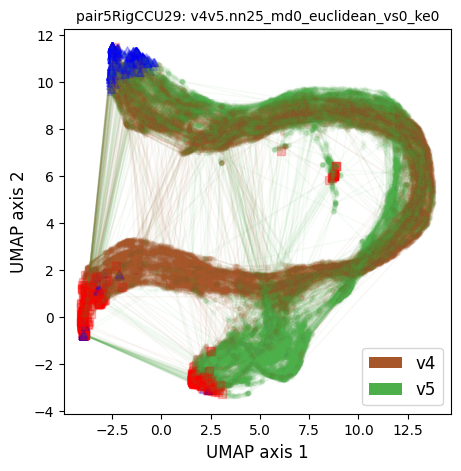

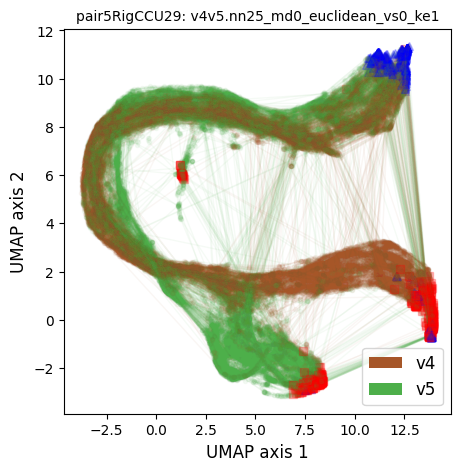

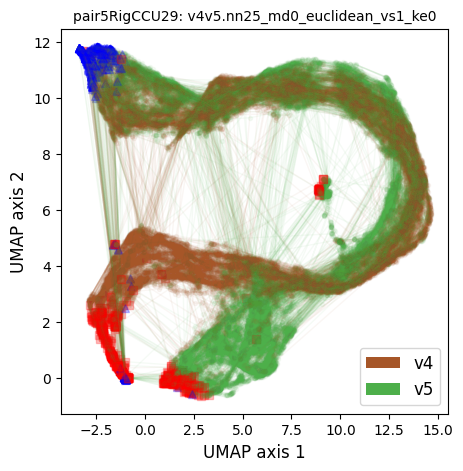

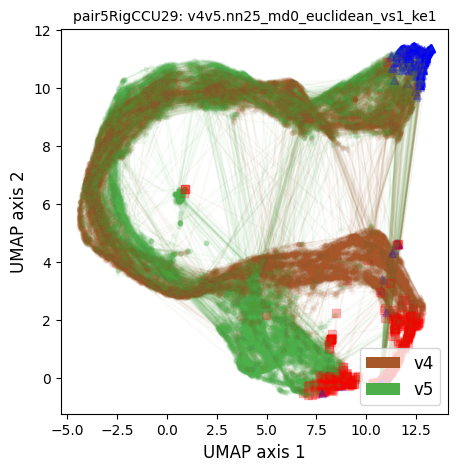

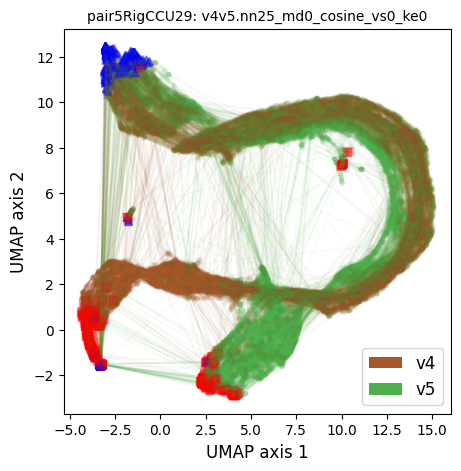

...

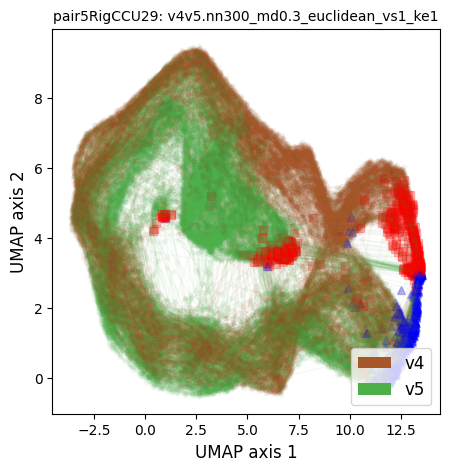

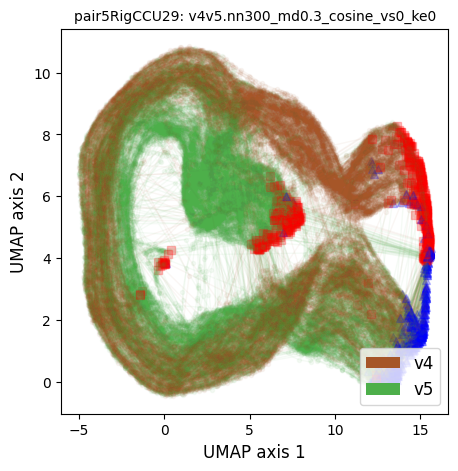

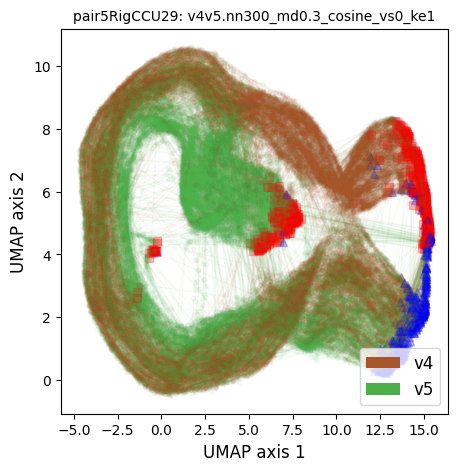

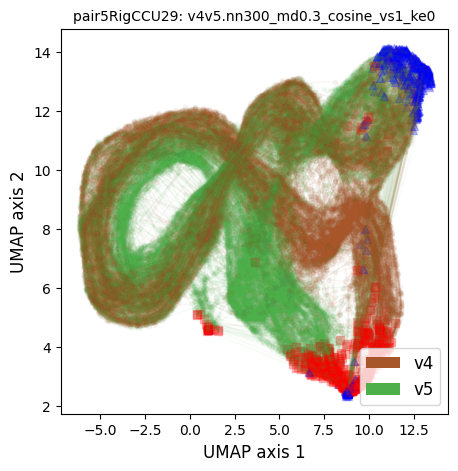

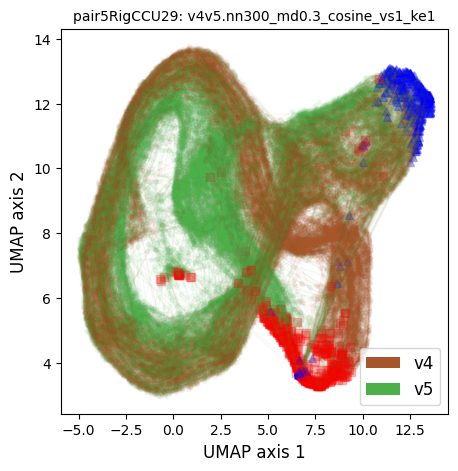

In [31]:
for nn in n_neighbors:
    for md in min_dist:
        for mt in metrics:
            for vs in vae_standard:
                for ke in knn_exact:
                    
                    # set a run name 
                    run_name = f'{syl_str}.nn{nn}_md{md}_{mt}_vs{vs}_ke{ke}'
                    fd_save_run = os.path.join(fd_save, run_name)
                    if not os.path.exists(fd_save_run):
                        os.makedirs(fd_save_run)
                    print(fd_save_run)

                    d = latent_comb.copy()

                    # standarize vae latents if specified
                    if vs==1:
                        scaler = StandardScaler(with_mean=True, with_std=True)
                        d = scaler.fit_transform(d)     # same shape as d

                    # run UMAP 
                    if ke==1:
                        # first calculate the exact k-NN
                        nbrs = NearestNeighbors(n_neighbors=nn, algorithm='brute', metric=mt, n_jobs=-1).fit(d)
                        distances, indices = nbrs.kneighbors(d, return_distance=True)
                        indices   = indices.astype(np.int64,  copy=False)
                        distances = distances.astype(np.float32, copy=False)
                        umap_model = umap.UMAP(n_neighbors=nn, n_components=2, min_dist=md, metric=mt, random_state=1118, low_memory=False, verbose=True, precomputed_knn=(indices, distances))
                    else:
                        umap_model = umap.UMAP(n_neighbors=nn, n_components=2, min_dist=md, metric=mt, random_state=1118, verbose=True)
                    res = umap_model.fit_transform(d)

                    # put results in a master dataframe
                    embed = info_comb.copy()
                    for ii in range(d.shape[1]):
                        embed[f'vae{ii}'] = d[:,ii]
                    for jj in range(res.shape[1]):
                        embed[f'umap{jj+1}'] = res[:,jj]

                    # save the embedding
                    fn_embed = os.path.join(fd_save_run, f'{birdID}.{run_name}.embedding.csv')
                    embed.to_csv(fn_embed)

                    #### plot results, different color for different call subtypes
                    col_full = ['#a65628','#4daf4a','#984ea3','#e41a1c','#ff7f00','#f781bf','#377eb8','#737373']
                    col_dict = OrderedDict(zip(v_all, col_full[0:len(v_all)]))
                    # get the syl id
                    syl_comb = list(set(info_comb['syl_id']))
                    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=[5, 5])
                    for si in range(len(syl_comb)):
                        ss = syl_comb[si]
                        embed_s = embed[embed['syl_id']==ss]
                        embed_s.index = range(embed_s.shape[0])
                        x = np.array(embed_s['umap1'])
                        y = np.array(embed_s['umap2'])
                        v = embed_s['call_subtype'][0]
                        ax.plot(x, y,  marker='o', linestyle='-', color=col_dict[v], markersize=3, linewidth=1, alpha=0.05)
                        # mark the start with triangle, and end with square
                        ax.plot(x[0], y[0], marker='^', markersize=6, color='blue', alpha=0.25)
                        ax.plot(x[-1], y[-1], marker='s', markersize=6, color='red', alpha=0.25)
                    # add legend
                    legends = [Patch(facecolor=col_dict[name], label=name) for name in col_dict.keys()]
                    ax.legend(handles=legends, loc='lower right', fontsize=12)
                    ax.set_title(f'{birdID}: {run_name}', fontsize=10)
                    ax.set_xlabel('UMAP axis 1', fontsize=12)
                    ax.set_ylabel('UMAP axis 2', fontsize=12)
                    # # plt.tight_layout()
                    # save fig
                    fn_fig =os.path.join(fd_save_run, f'{birdID}.{run_name}.embedding.pdf')
                    fig.savefig(fn_fig)

## 3. Combine the plots

In [32]:
col_full = ['#a65628','#4daf4a','#984ea3','#e41a1c','#ff7f00','#f781bf','#377eb8','#737373']
col_dict = OrderedDict(zip(v_all, col_full[0:len(v_all)]))
# get the syl id
syl_comb = list(set(info_comb['syl_id']))

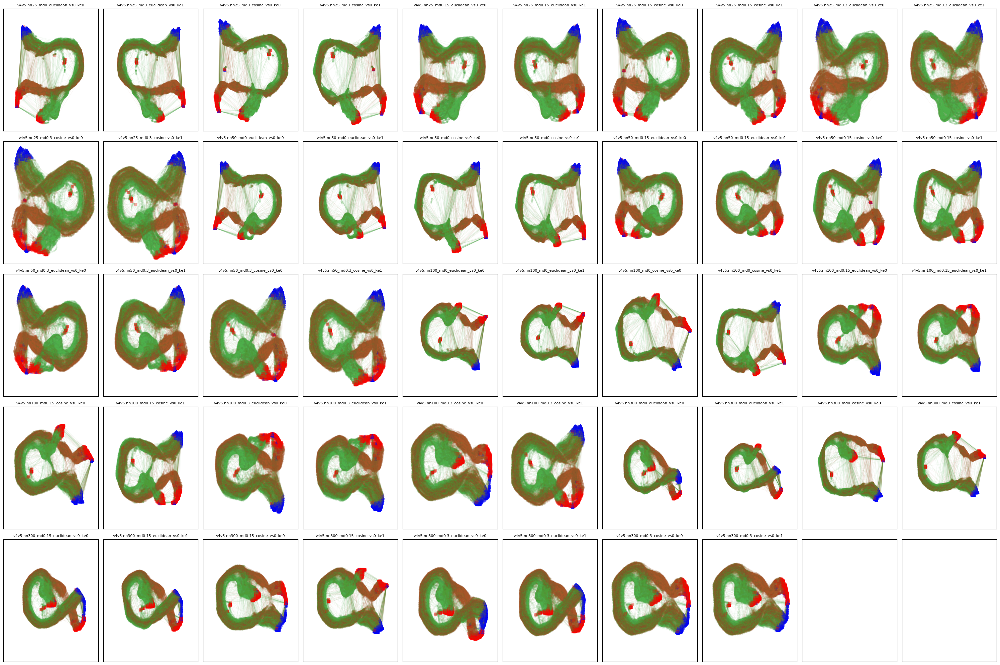

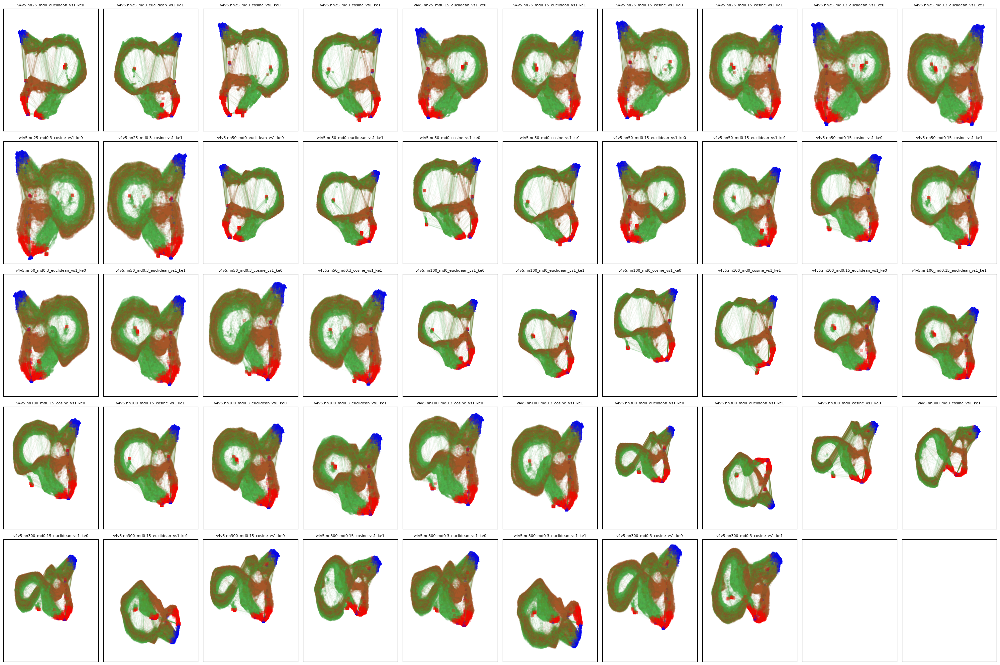

In [37]:
for vs in vae_standard:
    fig, axes = plt.subplots(nrows=5, ncols=10, figsize=[30, 20], sharex=True, sharey=True)
    count = 0;
    for nn in n_neighbors:
        for md in min_dist:
            for mt in metrics: 
                for ke in knn_exact:
                    # read in data
                    run_name = f'{syl_str}.nn{nn}_md{md}_{mt}_vs{vs}_ke{ke}'
                    fd_save_run = os.path.join(fd_save, run_name)
                    fn_embed = os.path.join(fd_save_run, f'{birdID}.{run_name}.embedding.csv')
                    embed = pd.read_csv(fn_embed, index_col=0)
                    # plot
                    plot_i = count // 10
                    plot_j = count % 10
                    ax = axes[plot_i][plot_j]
                    for si in range(len(syl_comb)):
                        ss = syl_comb[si]
                        embed_s = embed[embed['syl_id']==ss]
                        embed_s.index = range(embed_s.shape[0])
                        x = np.array(embed_s['umap1'])
                        y = np.array(embed_s['umap2'])
                        v = embed_s['call_subtype'][0]
                        ax.plot(x, y,  marker='o', linestyle='-', color=col_dict[v], markersize=3, linewidth=1, alpha=0.05)
                        # mark the start with triangle, and end with square
                        ax.plot(x[0], y[0], marker='^', markersize=6, color='blue', alpha=0.25)
                        ax.plot(x[-1], y[-1], marker='s', markersize=6, color='red', alpha=0.25)
                    ax.set_xticks([])
                    ax.set_yticks([])
                    ax.set_title(run_name, fontsize=8)
                    count +=1
    plt.tight_layout()
    fn_fig = os.path.join(fd_save, f'{birdID}.combined.vs{vs}.jpg')
    fig.savefig(fn_fig, format='jpg', dpi=300)